# Table of Contents
1. [Introduction](#introduction)
2. [Retrieve jobs from Ceph and map to JSON dataframe](#display-jobs-in-dataframe)

## Introduction <a name="introduction"></a>

**Overview**

The purpose of this notebook is to give context to software stacks with errors analyzed. Currently grafana metrics from the SolverResultsStore show over 661k results. This notebook filters for documents with solver errors. Within the results, there are currently three different solvers:
- solver-rhel-8.0-py36
- solver-fedora-31-py38
- solver-fedora31-py37

Each solver has around 20k - 30k results with solver error. These errors are classified:
- unparseable
- unsolvable (due to missing packages/missing components)
- other


## Retrieve jobs from Ceph and map to JSON dataframe <a name="display-jobs-in-dataframe"></a>

In [1]:
%env THOTH_DEPLOYMENT_NAME     thoth-psi-stage
%env THOTH_CEPH_BUCKET         thoth
%env THOTH_CEPH_BUCKET_PREFIX  data/thoth
%env THOTH_S3_ENDPOINT_URL     https://s3.upshift.redhat.com 

env: THOTH_DEPLOYMENT_NAME=thoth-psi-stage
env: THOTH_CEPH_BUCKET=thoth
env: THOTH_CEPH_BUCKET_PREFIX=data/thoth
env: THOTH_S3_ENDPOINT_URL=https://s3.upshift.redhat.com


In [721]:
from pprint import pprint
import random
from bs4 import BeautifulSoup
from nltk.tokenize import RegexpTokenizer
from nltk.corpus import stopwords
import matplotlib.pyplot as plt
import string

import numpy as np
from sklearn.feature_extraction.text import TfidfVectorizer
from sklearn.cluster import KMeans

from pandas.io.json import json_normalize
import json
import pandas as pd
from IPython.display import display, Markdown
from thoth.storages import SolverResultsStore
from thoth.storages.result_base import ResultStorageBase
from IPython.display import clear_output
import matplotlib.pyplot as plt
from mpl_toolkits.mplot3d import Axes3D


### Functions

In [230]:
def printmd(string):
    """Alternate print function implementing markdown formatting
    
    :param string: string to print.
    """
    display(Markdown(string))

In [237]:
def get_solver_document(num_of_documents):
    #DO NOT RUN THIS
    count_solver_error = 0
    count_no_error = 0
    solver_results = []
    for document_id in solver_store.get_document_listing():
        document = solver_store.retrieve_document(document_id)
        if len(document.get('result').get('errors')) is not 0:
            solver_results.append(document)
            count_solver_error +=1
        else:
            count_no_error +=1
        clear_output()
        print("With error:", count_solver_error, "Without error:", count_no_error)
        if(count_solver_error == num_of_documents):
            break
    return solver_results

In [243]:
def get_list_of_columns_to_analyze(df_solver_results: pd.DataFrame):
    lst_columns_to_analyze = []
    printmd("#### Columns to analyze, Unique Value Count")
    for i in df_solver_results:
        try:
            value_count = len(df_solver_results.groupby(i).count())

            if (value_count > 1):
                print(i, value_count)
                lst_columns_to_analyze.append(i)
        except TypeError:
            #Groups every column by unique values if values are in list or dict formats
            try:
                value_count = len(pd.Series(df_solver_results[i].values).apply(tuple).unique())
                if (value_count > 1):
                    print(i, value_count)
                    lst_columns_to_analyze.append(i)
            except TypeError:
                l = (list(df_solver_results[i].values))
                value_count = len([i for n, i in enumerate(l) if i not in l[n + 1:]])
                if (value_count > 1):
                    print(i, value_count)
                    lst_columns_to_analyze.append(i)
                pass
    return lst_columns_to_analyze


In [535]:
#remove punctuation
def remove_punctuation(text):
    no_punct = "".join([c for c in text if c not in string.punctuation])
    return no_punct

#tokenization
tokenizer = RegexpTokenizer(r'\w+')

#Stopwords
def stopwords_remove(text):
    words = [w for w in text if w not in stopwords.words('english')]
    return words

#remove list
def remove_list(text):
    no_list = ','.join(text)
    return no_list

#remove next line
def remove_next_line(text):
    new_text = text.split('\n')
    return new_text

#remove spacing runs
def remove_spacing_runs(text):
    clean_text = re.sub("\s\s+" , " ", text)
    return clean_text

### Load Data

In [4]:
#Connect to solver results store
solver_store = SolverResultsStore()
solver_store.connect()

In [5]:
#DO NOT RUN THIS- gets all solver ids
solver_results = []
solver_ids = []
for document_id in solver_store.get_document_listing():
    solver_ids.append(document_id)
    

In [231]:
len(solver_ids)

664719

In [251]:
#Sample of what a solver id looks like
solver_ids[0:5]

['solver-fedora-31-py37-000020c0',
 'solver-fedora-31-py37-00006c30',
 'solver-fedora-31-py37-00007021',
 'solver-fedora-31-py37-00007e6e',
 'solver-fedora-31-py37-0002ab98']

In [255]:
#Print the solvers included in the data
solvers = []
for elem in solver_ids:
    solvers.append(elem[0:19])
unique_solvers = str(list(set(solvers)))

printmd("### Solvers to analyze")
printmd(unique_solvers)

### Solvers to analyze

['solver-fedora-31-py', 'solver-rhel-8-py36-', 'solver-rhel-8.0-py3']

In [238]:
#Get set of solver documents to analyze
solver_results = get_solver_document(2000)

With error: 2000 Without error: 10545


In [302]:
len(solver_results)

2000

In [433]:
#Example of a solver result error
text = solver_results[255]['result']['errors'][0]['details']['message']

### Display full Error

In [458]:
text

'Command exited with non-zero status code (1):   ERROR: Command errored out with exit status 1:\n   command: /home/solver/venv/bin/python3 -u -c \'import sys, setuptools, tokenize; sys.argv[0] = \'"\'"\'/tmp/pip-install-q__c9wn6/libsass/setup.py\'"\'"\'; __file__=\'"\'"\'/tmp/pip-install-q__c9wn6/libsass/setup.py\'"\'"\';f=getattr(tokenize, \'"\'"\'open\'"\'"\', open)(__file__);code=f.read().replace(\'"\'"\'\\r\\n\'"\'"\', \'"\'"\'\\n\'"\'"\');f.close();exec(compile(code, __file__, \'"\'"\'exec\'"\'"\'))\' bdist_wheel -d /tmp/pip-wheel-4yf04q2t --python-tag cp37\n       cwd: /tmp/pip-install-q__c9wn6/libsass/\n  Complete output (21 lines):\n  running bdist_wheel\n  running build\n  running build_py\n  creating build\n  creating build/lib.linux-x86_64-3.7\n  copying sass.py -> build/lib.linux-x86_64-3.7\n  copying sassc.py -> build/lib.linux-x86_64-3.7\n  copying sasstests.py -> build/lib.linux-x86_64-3.7\n  creating build/lib.linux-x86_64-3.7/sassutils\n  copying sassutils/distutils.py

In [459]:
x = remove_next_line(text)

In [460]:
#split up components of error message by the \n valueb
x

['Command exited with non-zero status code (1):   ERROR: Command errored out with exit status 1:',
 '   command: /home/solver/venv/bin/python3 -u -c \'import sys, setuptools, tokenize; sys.argv[0] = \'"\'"\'/tmp/pip-install-q__c9wn6/libsass/setup.py\'"\'"\'; __file__=\'"\'"\'/tmp/pip-install-q__c9wn6/libsass/setup.py\'"\'"\';f=getattr(tokenize, \'"\'"\'open\'"\'"\', open)(__file__);code=f.read().replace(\'"\'"\'\\r\\n\'"\'"\', \'"\'"\'\\n\'"\'"\');f.close();exec(compile(code, __file__, \'"\'"\'exec\'"\'"\'))\' bdist_wheel -d /tmp/pip-wheel-4yf04q2t --python-tag cp37',
 '       cwd: /tmp/pip-install-q__c9wn6/libsass/',
 '  Complete output (21 lines):',
 '  running bdist_wheel',
 '  running build',
 '  running build_py',
 '  creating build',
 '  creating build/lib.linux-x86_64-3.7',
 '  copying sass.py -> build/lib.linux-x86_64-3.7',
 '  copying sassc.py -> build/lib.linux-x86_64-3.7',
 '  copying sasstests.py -> build/lib.linux-x86_64-3.7',
 '  creating build/lib.linux-x86_64-3.7/sassut

## Components of one error message

In [461]:
x[0]

'Command exited with non-zero status code (1):   ERROR: Command errored out with exit status 1:'

In [462]:
x[1]

'   command: /home/solver/venv/bin/python3 -u -c \'import sys, setuptools, tokenize; sys.argv[0] = \'"\'"\'/tmp/pip-install-q__c9wn6/libsass/setup.py\'"\'"\'; __file__=\'"\'"\'/tmp/pip-install-q__c9wn6/libsass/setup.py\'"\'"\';f=getattr(tokenize, \'"\'"\'open\'"\'"\', open)(__file__);code=f.read().replace(\'"\'"\'\\r\\n\'"\'"\', \'"\'"\'\\n\'"\'"\');f.close();exec(compile(code, __file__, \'"\'"\'exec\'"\'"\'))\' bdist_wheel -d /tmp/pip-wheel-4yf04q2t --python-tag cp37'

In [439]:
x[-2]

'ERROR: Command errored out with exit status 1: /home/solver/venv/bin/python3 -u -c \'import sys, setuptools, tokenize; sys.argv[0] = \'"\'"\'/tmp/pip-install-q__c9wn6/libsass/setup.py\'"\'"\'; __file__=\'"\'"\'/tmp/pip-install-q__c9wn6/libsass/setup.py\'"\'"\';f=getattr(tokenize, \'"\'"\'open\'"\'"\', open)(__file__);code=f.read().replace(\'"\'"\'\\r\\n\'"\'"\', \'"\'"\'\\n\'"\'"\');f.close();exec(compile(code, __file__, \'"\'"\'exec\'"\'"\'))\' install --record /tmp/pip-record-tuf1nrca/install-record.txt --single-version-externally-managed --compile --install-headers /home/solver/venv/include/site/python3.7/libsass Check the logs for full command output.'

In [440]:
x[-4]

"    error: command 'gcc' failed with exit status 1"

In [441]:
x[-5]

"    unable to execute 'gcc': No such file or directory"

In [442]:
x[2:-6]

['       cwd: /tmp/pip-install-q__c9wn6/libsass/',
 '  Complete output (21 lines):',
 '  running bdist_wheel',
 '  running build',
 '  running build_py',
 '  creating build',
 '  creating build/lib.linux-x86_64-3.7',
 '  copying sass.py -> build/lib.linux-x86_64-3.7',
 '  copying sassc.py -> build/lib.linux-x86_64-3.7',
 '  copying sasstests.py -> build/lib.linux-x86_64-3.7',
 '  creating build/lib.linux-x86_64-3.7/sassutils',
 '  copying sassutils/distutils.py -> build/lib.linux-x86_64-3.7/sassutils',
 '  copying sassutils/builder.py -> build/lib.linux-x86_64-3.7/sassutils',
 '  copying sassutils/__init__.py -> build/lib.linux-x86_64-3.7/sassutils',
 '  copying sassutils/wsgi.py -> build/lib.linux-x86_64-3.7/sassutils',
 '  running build_ext',
 "  building '_sass' extension",
 '  creating build/temp.linux-x86_64-3.7',
 '  creating build/temp.linux-x86_64-3.7/libsass',
 '  creating build/temp.linux-x86_64-3.7/libsass/src',
 '  gcc -pthread -Wno-unused-result -Wsign-compare -DDYNAMIC_AN

In [257]:
#Turn Solver results into a dataframe
df_solver_results = json_normalize(solver_results, sep = "_")

In [258]:
lst_columns_to_analyze = get_list_of_columns_to_analyze(df_solver_results)

#### Columns to analyze, Unique Value Count

metadata_arguments_python_index 3
metadata_arguments_python_requirements 2000
metadata_datetime 2000
metadata_document_id 2000
metadata_duration 49
metadata_hostname 2000
metadata_timestamp 1734
result_errors 2000
result_tree 28
result_unresolved 38


In [399]:
#Obtain dataframe only of column that needs analysis
df_solver_results_to_analyze = df_solver_results[lst_columns_to_analyze]

In [400]:
df_solver_results_to_analyze.head(3)

metadata_arguments_python_index metadata_arguments_python_requirements  \
0  https://pypi.org/simple         json2html==1.1.0                        
1  https://pypi.org/simple         guillotina==1.3.0                       
2  https://pypi.org/simple         documenttemplate==2.13.4                

            metadata_datetime            metadata_document_id  \
0  2019-12-27T17:17:58.575766  solver-fedora-31-py37-00087c38   
1  2019-12-24T16:38:05.389304  solver-fedora-31-py37-0009d0a4   
2  2019-12-24T16:38:10.581721  solver-fedora-31-py37-000d5133   

   metadata_duration                     metadata_hostname  \
0  2                  solver-fedora-31-py37-00087c38-hsv2c   
1  4                  solver-fedora-31-py37-0009d0a4-qdpqp   
2  2                  solver-fedora-31-py37-000d5133-kxp5g   

   metadata_timestamp  \
0  1577467078           
1  1577205485           
2  1577205490           

                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                              

# Components of all error messages

In [633]:
df_error_components = pd.DataFrame()

In [634]:
def get_ERROR(text):
    value = "Command exited with non-zero status code (1):"
    if value in text:
        text = text.replace(value, "")
    text = ' '.join(text.split())
    return text

In [635]:
df_error_components['result_errors'] = df_solver_results_to_analyze['result_errors']
df_error_components['message'] = df_error_components.apply(lambda row: row.result_errors[0]['details']['message'], axis=1)
df_error_components['tokenized_message'] = df_error_components.apply(lambda row: remove_next_line(row.message),axis = 1)
df_error_components['exit_status'] = df_error_components.apply(lambda row: row.tokenized_message[0],axis = 1)
df_error_components['exit_status_ERROR'] = df_error_components.apply(lambda row: get_ERROR(row.exit_status), axis = 1)
df_error_components['command'] = df_error_components["tokenized_message"].str[1]
df_error_components['ERROR'] = df_error_components["tokenized_message"].str[-2]
df_error_components['error_info'] = df_error_components["tokenized_message"].str[-4]
df_error_components['error_label'] = df_error_components["tokenized_message"].str[-5]
df_error_components['cwd_info'] = df_error_components["tokenized_message"].str[2:-6]

In [722]:
df_error_components['error_for_analysis'] = df_error_components['error_info'] + df_error_components['error_label']

In [723]:
df_error_components.head()

result_errors  \
0  [{'details': {'command': '/home/solver/venv/bin/python3 -m pip install --force-reinstall --no-cache-dir --no-deps json2html==1.1.0 --index-url "https://pypi.org/simple"  --trusted-host pypi.org', 'message': 'Command exited with non-zero status code (1):     ERROR: Command errored out with exit status 1:
     command: /home/solver/venv/bin/python3 -c 'import sys, setuptools, tokenize; sys.argv[0] = '"'"'/tmp/pip-install-1eq417ji/json2html/setup.py'"'"'; __file__='"'"'/tmp/pip-install-1eq417ji/json2html/setup.py'"'"';f=getattr(tokenize, '"'"'open'"'"', open)(__file__);code=f.read().replace('"'"'\r\n'"'"', '"'"'\n'"'"');f.close();exec(compile(code, __file__, '"'"'exec'"'"'))' egg_info --egg-base /tmp/pip-install-1eq417ji/json2html/pip-egg-info
         cwd: /tmp/pip-install-1eq417ji/json2html/
    Complete output (5 lines):
    Traceback (most recent call last):
      File "<string>", line 1, in <module>
      File "/tmp/pip-install-1eq417ji/json2html/setup.py", line 17, in <module>
        long_description=open('README.md').read(),
    FileNotFoundError: [Errno 2] No such file or directory: 'README.md'
    ----------------------------------------
ERROR: Command errored out with exit status 1: python setup.py egg_info Check the logs for full command output.
', 'return_code': 1, 'stderr': '    ERROR: Command errored out with exit status 1:
     command: /home/solver/venv/bin/python3 -c 'import sys, setuptools, tokenize; sys.argv[0] = '"'"'/tmp/pip-install-1eq417ji/json2html/setup.py'"'"'; __file__='"'"'/tmp/pip-install-1eq417ji/json2html/setup.py'"'"';f=getattr(tokenize, '"'"'open'"'"', open)(__file__);code=f.read().replace('"'"'\r\n'"'"', '"'"'\n'"'"');f.close();exec(compile(code, __file__, '"'"'exec'"'"'))' egg_info --egg-base /tmp/pip-install-1eq417ji/json2html/pip-egg-info
         cwd: /tmp/pip-install-1eq417ji/json2html/
    Complete output (5 lines):
    Traceback (most recent call last):
      File "<string>", line 1, in <module>
      File "/tmp/pip-install-1eq417ji/json2html/setup.py", line 17, in <module>
        long_description=open('README.md').read(),
    FileNotFoundError: [Errno 2] No such file or directory: 'README.md'
    ----------------------------------------
ERROR: Command errored out with exit status 1: python setup.py egg_info Check the logs for full command output.
', 'stdout': 'Collecting json2html==1.1.0
  Downloading https://files.pythonhosted.org/packages/70/3b/a0866f9a1ca7f3347546614770221a0061a8ea0ac5b7df053c6e55273ac8/json2html-1.1.0.tar.gz
', 'timeout': 60}, 'index_url': 'https://pypi.org/simple', 'is_provided_package': True, 'is_provided_package_version': True, 'package_name': 'json2html', 'package_version': '1.1.0', 'type': 'command_error'}]                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                           

In [725]:
get_list_of_columns_to_analyze(df_error_components)

#### Columns to analyze, Unique Value Count

result_errors 2000
message 1990
tokenized_message 1990
exit_status 430
exit_status_ERROR 428
command 1973
ERROR 868
error_info 374
error_label 421
cwd_info 1535
exit_status_ERROR_processed 428
error_info_processed 371
message_processed 374
error_for_analysis 541


['result_errors',
 'message',
 'tokenized_message',
 'exit_status',
 'exit_status_ERROR',
 'command',
 'ERROR',
 'error_info',
 'error_label',
 'cwd_info',
 'exit_status_ERROR_processed',
 'error_info_processed',
 'message_processed',
 'error_for_analysis']

In [724]:
df_error_components['exit_status_ERROR'].unique()

array(['ERROR: Command errored out with exit status 1:',
       'ERROR: Could not find a version that satisfies the requirement cbapi==0.9.0 (from versions: 0.8.0, 0.8.1, 0.9.1, 0.9.2, 0.9.3, 0.9.4, 0.9.5, 0.9.6, 0.9.7, 0.9.8, 1.0.0, 1.0.1, 1.1.0, 1.1.1, 1.2.0, 1.3.0, 1.3.1, 1.3.2, 1.3.3, 1.3.4, 1.3.5, 1.3.6, 1.4.0, 1.4.1, 1.4.2, 1.4.3, 1.4.4, 1.4.5, 1.5.0, 1.5.1, 1.5.2, 1.5.3, 1.5.4, 1.5.5, 1.5.6, 1.6.0)',
       'ERROR: Could not find a version that satisfies the requirement lupa==0.2 (from versions: 0.4, 0.5, 0.6, 0.7, 0.8, 0.9, 0.10, 0.11, 0.12, 0.13, 0.13.1, 0.14, 0.15, 0.16, 0.17, 0.18, 0.19, 0.20, 0.21, 1.0b1, 1.0, 1.0.1, 1.1, 1.2, 1.3, 1.4, 1.5, 1.6, 1.7, 1.8, 1.9)',
       'Failed to successfully execute function in Python interpreter: Fatal Python error: initsite: Failed to import the site module',
       'ERROR: Could not find a version that satisfies the requirement netifaces==0.6 (from versions: 0.8, 0.10.0, 0.10.1, 0.10.2, 0.10.3, 0.10.4, 0.10.5, 0.10.6, 0.10.7, 0.10.8, 0

In [651]:
df_error_components['error_info'].unique()

array(["    FileNotFoundError: [Errno 2] No such file or directory: 'README.md'",
       "    error: command 'gcc' failed with exit status 1",
       "    NameError: name 'execfile' is not defined",
       '    SyntaxError: invalid syntax',
       "    ModuleNotFoundError: No module named 'numpy'",
       "    FileNotFoundError: [Errno 2] No such file or directory: '/System/Library/CoreServices/SystemVersion.plist'",
       "    FileNotFoundError: [Errno 2] No such file or directory: 'cc': 'cc'",
       '    TypeError: expected str, bytes or os.PathLike object, not _io.TextIOWrapper',
       nan,
       "    FileNotFoundError: [Errno 2] No such file or directory: '/tmp/pip-install-se5rp040/premailer/setup.py'",
       "    NameError: name 'file' is not defined",
       "    ModuleNotFoundError: No module named 'auxlib'", '    ',
       '    SyntaxError: Missing parentheses in call to \'print\'. Did you mean print("Biopython requires Python 2.4 or better.  Python %d.%d detected" % \\)?'

In [686]:
#Remove stopwords from exit_status_Error column
def process_exit_status_ERROR(text):
    if "ERROR:" in text:
        text = text.replace("ERROR: ", "")
    if "Command errored out with exit status 1:" in text:
        text = text.replace("Command errored out with exit status 1:", "exitStatus1")
    if "Could not find a version that satisfies the requirement" in text:
        text = text.replace("Could not find a version that satisfies the requirement", "CouldNotFindVersionRequirement")
    if " (from versions:" in text:
        text = text.split(" (from versions: ")
    if len(text) == 2:
        text = text[0]
    return text

In [687]:
#Remove stopwords from error info
def process_error_info(text):
    if isinstance(text, str):
        text = ' '.join(text.split())
        if " [Errno 2] No such file or directory: " in text:
            text = text.replace(" [Errno 2] No such file or directory: ", " ")
        if "NameError:" in text:
            text = text.replace(" name ", " ")
            text = text.replace(" is not defined", "")
        if "ModuleNotFoundError:" in text:
            text = text.replace("No module named ", "")
    return text

In [699]:
def message_processing(text):
    if not isinstance(text, str):
        text = ""
        
    return text

In [700]:
df_error_components['exit_status_ERROR_processed'] = df_error_components.apply(lambda row: remove_stopwords(row.exit_status_ERROR),axis = 1)
df_error_components['error_info_processed'] = df_error_components.apply(lambda row: process_error_info(row.error_info),axis = 1)
df_error_components["message_processed"] = df_error_components["exit_status_ERROR_processed"] + " " + df_error_components["error_info_processed"]
df_error_components["message_processed"] = df_error_components.apply(lambda row: message_processing(row.message_processed),axis = 1)

In [701]:
df_processed = df_error_components
df_processed = df_processed.drop(["tokenized_message", "message", "result_errors", "cwd_info"], axis=1)

In [702]:
df_processed

,exit_status,exit_status_ERROR,command,ERROR,error_info,error_label,exit_status_ERROR_processed,error_info_processed,message_processed
0,Command exited with non-zero status code (1): ERROR: Command errored out with exit status 1:,ERROR: Command errored out with exit status 1:,"command: /home/solver/venv/bin/python3 -c 'import sys, setuptools, tokenize; sys.argv[0] = '""'""'/tmp/pip-install-1eq417ji/json2html/setup.py'""'""'; __file__='""'""'/tmp/pip-install-1eq417ji/json2html/setup.py'""'""';f=getattr(tokenize, '""'""'open'""'""', open)(__file__);code=f.read().replace('""'""'\r\n'""'""', '""'""'\n'""'""');f.close();exec(compile(code, __file__, '""'""'exec'""'""'))' egg_info --egg-base /tmp/pip-install-1eq417ji/json2html/pip-egg-info",ERROR: Command errored out with exit status 1: python setup.py egg_info Check the logs for full command output.,FileNotFoundError: [Errno 2] No such file or directory: 'README.md',"long_description=open('README.md').read(),",exitStatus1,FileNotFoundError: 'README.md',exitStatus1 FileNotFoundError: 'README.md'
1,Command exited with non-zero status code (1): ERROR: Command errored out with exit status 1:,ERROR: Command errored out with exit status 1:,"command: /home/solver/venv/bin/python3 -u -c 'import sys, setuptools, tokenize; sys.argv[0] = '""'""'/tmp/pip-install-5y8hsn2x/guillotina/setup.py'""'""'; __file__='""'""'/tmp/pip-install-5y8hsn2x/guillotina/setup.py'""'""';f=getattr(tokenize, '""'""'open'""'""', open)(__file__);code=f.read().replace('""'""'\r\n'""'""', '""'""'\n'""'""');f.close();exec(compile(code, __file__, '""'""'exec'""'""'))' bdist_wheel -d /tmp/pip-wheel-l0mjgi64 --python-tag cp37","ERROR: Command errored out with exit status 1: /home/solver/venv/bin/python3 -u -c 'import sys, setuptools, tokenize; sys.argv[0] = '""'""'/tmp/pip-install-5y8hsn2x/guillotina/setup.py'""'""'; __file__='""'""'/tmp/pip-install-5y8hsn2x/guillotina/setup.py'""'""';f=getattr(tokenize, '""'""'open'""'""', open)(__file__);code=f.read().replace('""'""'\r\n'""'""', '""'""'\n'""'""');f.close();exec(compile(code, __file__, '""'""'exec'""'""'))' install --record /tmp/pip-record-mogjhdnl/install-record.txt --single-version-externally-managed --compile --install-headers /home/solver/venv/include/site/python3.7/guillotina Check the logs for full command output.",error: command 'gcc' failed with exit status 1,unable to execute 'gcc': No such file or directory,exitStatus1,error: command 'gcc' failed with exit status 1,exitStatus1 error: command 'gcc' failed with exit status 1
2,Command exited with non-zero status code (1): ERROR: Command errored out with exit status 1:,ERROR: Command errored out with exit status 1:,"command: /home/solver/venv/bin/python3 -u -c 'import sys, setuptools, tokenize; sys.argv[0] = '""'""'/tmp/pip-install-rfhgqa6g/documenttemplate/setup.py'""'""'; __file__='""'""'/tmp/pip-install-rfhgqa6g/documenttemplate/setup.py'""'""';f=getattr(tokenize, '""'""'open'""'""', open)(__file__);code=f.read().replace('""'""'\r\n'""'""', '""'""'\n'""'""');f.close();exec(compile(code, __file__, '""'""'exec'""'""'))' bdist_wheel -d /tmp/pip-wheel-0oa5n_91 --python-tag cp37","ERROR: Command errored out with exit status 1: /home/solver/venv/bin/python3 -u -c 'import sys, setuptools, tokenize; sys.argv[0] = '""'""'/tmp/pip-install-rfhgqa6g/documenttemplate/setup.py'""'""'; __file__='""'""'/tmp/pip-install-rfhgqa6g/documenttemplate/setup.py'""'""';f=getattr(tokenize, '""'""'open'""'""', open)(__file__);code=f.read().replace('""'""'\r\n'""'""', '""'""'\n'""'""');f.close();exec(compile(code, __file__, '""'""'exec'""'""'))' install --record /tmp/pip-record-0_kagnli/install-record.txt --single-version-externally-managed --compile --install-headers /home/solver/venv/include/site/python3.7/documenttemplate Check the logs for full command output.",error: command 'gcc' failed with exit status 1,unable to execute 'gcc': No such file or directory,exitStatus1,error: command 'gcc' failed with exit status 1,exitStatus1 error: com

In [739]:
from sklearn.feature_extraction.text import TfidfVectorizer
v = TfidfVectorizer()
x = v.fit_transform(df_processed['message_processed'])
x.toarray()

pd.DataFrame(x.toarray(), columns=v.get_feature_names()).head()

from sklearn.cluster import KMeans

number_of_clusters = 100
km = KMeans(n_clusters=number_of_clusters)
km.fit(x)
km.fit

printmd("### Top terms per cluster:")
order_centroids = km.cluster_centers_.argsort()[:, ::-1]
terms = v.get_feature_names()
for i in range(number_of_clusters):
    top_ten_words = [terms[ind] for ind in order_centroids[i, :20]]
    printmd("###### Cluster {}: {}".format(i, ' '.join(top_ten_words)))

### Top terms per cluster:

###### Cluster 0: modulenotfounderror exitstatus1 not py filenotfounderror the of config python install git or is for assertionerror typeerror importerror cannot and to

###### Cluster 1: gcc with failed exit status command error exitstatus1 from exiting facebookads f6uc3icv ez_setup extract extension export experimental expected exited frida

###### Cluster 2: syntax invalid syntaxerror exitstatus1 experimental fatal fasynchronous failed facebookads f6uc3icv ez_setup extract extension export expected fcf exiting exited exit exists

###### Cluster 3: coreservices plist systemversion system library filenotfounderror exitstatus1 extension fatal fasynchronous failed facebookads f6uc3icv ez_setup extract zvm export fbtest expected exiting

###### Cluster 4: numpy modulenotfounderror exitstatus1 zvm experimental fatal fasynchronous failed facebookads f6uc3icv ez_setup extract extension export expected fcf exiting exited exit exists

###### Cluster 5: print required missing is parentheses did mean call you in to for syntaxerror which compiling ncython kivy installation its python

###### Cluster 6: exitstatus1 zvm experimental fbtest fatal fasynchronous failed facebookads f6uc3icv ez_setup extract extension export expected geos_c exiting exited exit exists exist

###### Cluster 7: 403 httperror ssl error urllib http required is exitstatus1 export failed facebookads f6uc3icv ez_setup extract extension zvm experimental fasynchronous exiting

###### Cluster 8: supported yet python not is exitstatus1 importerror version export facebookads exe f6uc3icv ez_setup exec extract extension execfile experimental executable expected

###### Cluster 9: type operand unsupported for and typeerror builtin_function_or_method output_stream textiowrapper _io message file did mean print you exitstatus1 list dict_items filter

###### Cluster 10: execfile nameerror exitstatus1 zvm extension fcf fbtest fatal fasynchronous failed facebookads f6uc3icv ez_setup extract experimental export exe expected exiting exited

###### Cluster 11: req pip modulenotfounderror exitstatus1 experimental fatal fasynchronous failed facebookads f6uc3icv ez_setup extract extension export zvm expected fcf exiting exited exit

###### Cluster 12: unicode nameerror exitstatus1 zvm export fbtest fatal fasynchronous failed facebookads f6uc3icv ez_setup extract extension expected experimental fdb exiting exited exit

###### Cluster 13: six modulenotfounderror exitstatus1 expected fasynchronous failed facebookads f6uc3icv ez_setup extract extension export experimental zvm fbtest exiting exited exit exists exist

###### Cluster 14: nameerror file exitstatus1 zvm export fbtest fatal fasynchronous failed facebookads f6uc3icv ez_setup extract extension experimental fdb expected exiting exited exit

###### Cluster 15: compileerror verificationerror cffi gcc with failed exit status command exitstatus1 exist extension exec fasynchronous execfile facebookads f6uc3icv ez_setup extract export

###### Cluster 16: createsend __version__ name from __init__ importerror import cannot py tmp install pip 9y5psxva vvmdre8e nmi7lamy exitstatus1 format export experimental freetype

###### Cluster 17: pip deps quiet distutilserror wheel disable errors distutils check bin returned non zero venv solver home python3 tmp no version

###### Cluster 18: broken link simple toolchain program runtimeerror cannot exitstatus1 expected failed facebookads f6uc3icv ez_setup fwrapv extract extension export experimental fstack fatal

###### Cluster 19: not print installers makensis exe created can found be parentheses missing mean did call you in to syntaxerror exitstatus1 execute

###### Cluster 20: md readme filenotfounderror exitstatus1 tmp install pip reply email parser import 7patyyk1 sef7rw06 dockerpty pymacaroons facebookads x8_bozhh 8e5mvvep ghp wtjgp95d

###### Cluster 21: calledprocesserror subprocess returned zero non bin exit status command solver venv python3 home configure requirements sh run exitstatus1 install spdoc

###### Cluster 22: httplib modulenotfounderror exitstatus1 zvm experimental fatal fasynchronous failed facebookads f6uc3icv ez_setup extract extension export expected fcf exiting exited exit exists

###### Cluster 23: make error exitstatus1 filenotfounderror zvm extension fbtest fatal fasynchronous failed facebookads f6uc3icv ez_setup extract experimental export fdb expected exiting exited

###### Cluster 24: shapes modulenotfounderror exitstatus1 expected fasynchronous failed facebookads f6uc3icv ez_setup extract extension export experimental zvm fbtest exiting exited exit exists exist

###### Cluster 25: tried guess path but home the no in to command error exitstatus1 extension facebookads extract ez_setup f6uc3icv failed export zvm

###### Cluster 26: search_path print parentheses missing mean did call you in to syntaxerror exitstatus1 exit exists failed facebookads exec f6uc3icv execfile ez_setup

###### Cluster 27: in recent last traceback most function successfully execute interpreter line module python pkg_resources file packages lib site solver venv call

###### Cluster 28: bytes arg startswith first tuple must str of be typeerror or not exitstatus1 ez_setup zvm f6uc3icv failed fasynchronous facebookads export

###### Cluster 29: rst readme filenotfounderror exitstatus1 changelog changes tmp install pip yeaedmo8 wand flask admin muw7a2jy dns extract fbtest fatal disable dist

###### Cluster 30: print you to tag also want now probably the version parentheses missing mean did call in syntaxerror exitstatus1 exist execute

###### Cluster 31: version print greater been setuptools installed has or parentheses missing mean did call you in to syntaxerror exitstatus1 facebookads exec

###### Cluster 32: print output parentheses missing did mean call you in to syntaxerror exitstatus1 facebookads failed experimental ez_setup extract extension export f6uc3icv

###### Cluster 33: like bytes str object typeerror required is not exitstatus1 exists exit fasynchronous failed execfile facebookads f6uc3icv ez_setup executable extract extension

###### Cluster 34: requests modulenotfounderror exitstatus1 experimental fbtest fatal fasynchronous failed facebookads f6uc3icv ez_setup extract extension export zvm expected fdb exiting exited exit

###### Cluster 35: attribute attributeerror has module no urlretrieve exitstatus1 pip req urllib protocol_sslv3 async token ssl main getsitepackages subversion enum intflag sys

###### Cluster 36: print to you did parentheses missing mean call in syntaxerror exitstatus1 __version__ version not this using report macros install installed

###### Cluster 37: token invalid syntaxerror exitstatus1 export fbtest fatal fasynchronous failed facebookads f6uc3icv ez_setup extract extension expected experimental fdb exiting exited exit

###### Cluster 38: root critical exiting its headers are setup run and required numpy to exitstatus1 execute extension facebookads exec f6uc3icv execfile ez_setup

###### Cluster 39: followed interpolationsyntaxerror by configparser min css must found be or exitstatus1 dist f6uc3icv facebookads ez_setup export extract failed extension fasynchronous

###### Cluster 40: compile libvirt binary pkg exception config required python is to exitstatus1 extract fdb fcf fbtest fatal fasynchronous failed facebookads f6uc3icv

###### Cluster 41: pkg config filenotfounderror such directory probably installed or no file not exitstatus1 error exited exist facebookads f6uc3icv ez_setup extract executable

###### Cluster 42: cython modulenotfounderror exitstatus1 please install runtimeerror run installed no pip again try importerror and found not extension export experimental expected

###### Cluster 43: html parser package is not modulenotfounderror exitstatus1 export fasynchronous failed facebookads f6uc3icv ez_setup extract extension expected experimental fbtest exiting exited

###### Cluster 44: red hat 20190827 gcc using supported please version install exitstatus1 exited extract execfile executable failed execute facebookads f6uc3icv ez_setup exist

###### Cluster 45: uwsgi need compiler exception build you to exitstatus1 fasynchronous fatal failed experimental facebookads f6uc3icv ez_setup extract extension export exited expected

###### Cluster 46: module python fatal initsite in to string site function execute interpreter successfully failed line import the file error exists expected

###### Cluster 47: often called linux on setuptools package the python is exitstatus1 fatal fbtest extract failed facebookads f6uc3icv ez_setup fasynchronous zvm extension

###### Cluster 48: configparser modulenotfounderror exitstatus1 expected fatal fasynchronous failed facebookads f6uc3icv ez_setup extract extension export experimental zvm fcf exiting exited exit exists

###### Cluster 49: txt requirements filenotfounderror install tmp pip exitstatus1 docs test_requirements zappa conn conn_check history check readme version 2hxls64r gnupg owyuvq86 altair

###### Cluster 50: ez_setup modulenotfounderror exitstatus1 zvm experimental fbtest fatal fasynchronous failed facebookads f6uc3icv extract extension export expected fdb exiting exited exit exists

###### Cluster 51: print requires python to parentheses missing did mean call you in sentry syntaxerror least detected error at sphinx or exitstatus1

###### Cluster 52: dns modulenotfounderror exitstatus1 zvm export fcf fbtest fatal fasynchronous failed facebookads f6uc3icv ez_setup extract extension experimental fexceptions expected exiting exited

###### Cluster 53: tldextract name from __init__ importerror extract import cannot py tmp install pip owgl9v61 k_l5kl9w lst2ww2b lreplace _a6x7tla exitstatus1 found freetype

###### Cluster 54: im share create denied permission usr could not error exitstatus1 facebookads f6uc3icv ez_setup failed extract extension fasynchronous export zvm experimental

###### Cluster 55: bad escape re position at error exitstatus1 fcf fbtest fatal fasynchronous failed facebookads f6uc3icv ez_setup extension extract fexceptions export experimental

###### Cluster 56: aerospike scripts sh client error exitstatus1 executable export fatal exec fasynchronous failed facebookads f6uc3icv ez_setup extract extension experimental execute expected

###### Cluster 57: decode str object attribute attributeerror has no exitstatus1 zvm ez_setup fbtest fatal fasynchronous failed facebookads f6uc3icv export extract extension fdb

###### Cluster 58: len filter type object of has typeerror no exitstatus1 facebookads zvm ez_setup failed fasynchronous fatal fbtest f6uc3icv extension extract export

###### Cluster 59: swig with failed exit status command error exitstatus1 experimental facebookads f6uc3icv ez_setup extract extension export exiting expected exception exited exists

###### Cluster 60: version modulenotfounderror exitstatus1 zvm expected fatal fasynchronous failed facebookads f6uc3icv ez_setup extract extension export experimental exiting example exited exit exists

###### Cluster 61: ply modulenotfounderror xonsh exitstatus1 zvm export fatal fasynchronous failed facebookads f6uc3icv ez_setup extract extension expected experimental fcf exiting exited exit

###### Cluster 62: cc filenotfounderror exitstatus1 with failed exit status command error exists ez_setup fatal fasynchronous exec facebookads execfile executable f6uc3icv extract exist

###### Cluster 63: http client package is not modulenotfounderror exitstatus1 execute fatal fasynchronous failed facebookads executable f6uc3icv ez_setup extract extension exist export exec

###### Cluster 64: client modulenotfounderror exitstatus1 zvm fatal fasynchronous failed facebookads f6uc3icv ez_setup extract extension export experimental expected fcf exiting exited exit exists

###### Cluster 65: concat bytes can str typeerror to exitstatus1 export fatal fasynchronous failed facebookads f6uc3icv ez_setup extract extension zvm experimental expected fcf

###### Cluster 66: exec parentheses missing call in to syntaxerror exitstatus1 fasynchronous fatal facebookads f6uc3icv ez_setup extract extension export failed expected experimental fcf

###### Cluster 67: print higher zodb this requires of or version python parentheses missing mean did call you in to syntaxerror zeo exitstatus1

###### Cluster 68: before imported misc_util numpy install distutils please cannot be spglib installing pymatgen numpyfirst first 255 errored out with exit status

###### Cluster 69: does exist directory not package bodhi error client uncertainties src test egg_base typing exitstatus1 option build lib py or is

###### Cluster 70: mysql_config oserror found not exitstatus1 execute exist fatal fasynchronous failed facebookads f6uc3icv ez_setup exec extract extension export experimental expected fcf

###### Cluster 71: auxlib modulenotfounderror exitstatus1 zvm extension fcf fbtest fatal fasynchronous failed facebookads f6uc3icv ez_setup extract experimental export fexceptions expected exiting exited

###### Cluster 72: construct modulenotfounderror exitstatus1 zvm experimental fatal fasynchronous failed facebookads f6uc3icv ez_setup extract extension export expected fcf exiting exited exit exists

###### Cluster 73: urlparse modulenotfounderror exitstatus1 zvm experimental fatal fasynchronous failed facebookads f6uc3icv ez_setup extract extension export expected fcf exiting exited exit exists

###### Cluster 74: exists errors pkg config cairo 13 38 arguments glib print command exitstatus1 ez_setup fatal fbtest fasynchronous failed facebookads f6uc3icv expected

###### Cluster 75: urllib2 modulenotfounderror exitstatus1 zvm experimental fatal fasynchronous failed facebookads f6uc3icv ez_setup extract extension export expected fcf exiting exited exit exists

###### Cluster 76: urlopen egg frida py3 x86_64 linux error exitstatus1 exist execfile fasynchronous failed facebookads f6uc3icv ez_setup extract exec extension export exists

###### Cluster 77: 404 error found http not exitstatus1 zvm export fasynchronous failed facebookads f6uc3icv ez_setup extract extension expected experimental fbtest exiting exited

###### Cluster 78: sphinx modulenotfounderror exitstatus1 zvm fasynchronous failed facebookads f6uc3icv ez_setup extract extension export experimental expected exiting fbtest exited exit exists exist

###### Cluster 79: boltons en notimplementederror support route location your python to exitstatus1 exists ez_setup fatal fasynchronous execfile failed facebookads executable execute f6uc3icv

###### Cluster 80: above cuda log environment your check exception please is invalid error exitstatus1 expected facebookads f6uc3icv ez_setup extract extension export full

###### Cluster 81: set can attribute attributeerror exitstatus1 zvm ez_setup fcf fbtest fatal fasynchronous failed facebookads f6uc3icv extract fexceptions extension export experimental expected

###### Cluster 82: python mercurial weren 7m include headers usr but are build python3 found required in to exitstatus1 following ez_setup frida extract

###### Cluster 83: enable disable coincurve module tmp install pip prefix recovery static tracking gmp shared ecdh bignum pic jni libsecp256k1 dependency temp

###### Cluster 84: posix compliant really running print you os are parentheses missing mean did call in to syntaxerror exitstatus1 extract experimental ez_setup

###### Cluster 85: 255 out errored with exit status command extract ez_setup f6uc3icv zvm export facebookads failed fasynchronous fatal extension exitstatus1 experimental expected

###### Cluster 86: object attribute attributeerror has message no modulenotfounderror split version_info sys exitstatus1 ez_setup fatal fasynchronous executable execute failed facebookads exist f6uc3icv

###### Cluster 87: script hand print test it find by could run please py not parentheses missing mean did call you in to

###### Cluster 88: stackoverflow questions 22313407 com see http exitstatus1 zvm export fasynchronous failed facebookads f6uc3icv ez_setup extract extension expected experimental fbtest exiting

###### Cluster 89: reflection_commands modulenotfounderror exitstatus1 experimental fbtest fatal fasynchronous failed facebookads f6uc3icv ez_setup extract extension export zvm expected fdb exiting exited exit

###### Cluster 90: c2to3 experimental needs setup python3 py with exitstatus1 exists exit fatal exec fasynchronous failed facebookads f6uc3icv ez_setup extract extension export

###### Cluster 91: iteritems dict object attribute attributeerror has no exitstatus1 ez_setup fbtest fatal fasynchronous failed facebookads f6uc3icv extract fdb extension export experimental

###### Cluster 92: nonetype object iterable typeerror is not callable exitstatus1 exit extract execfile fasynchronous failed executable facebookads f6uc3icv ez_setup execute extension exited

###### Cluster 93: print coverage again try it could import please and install not parentheses missing did mean call you in to syntaxerror

###### Cluster 94: distribute_setup modulenotfounderror exitstatus1 zvm export fcf fbtest fatal fasynchronous failed facebookads f6uc3icv ez_setup extract extension expected experimental fexceptions exiting exited

###### Cluster 95: print in order needs to setuptools ansigenome build parentheses missing did mean call you syntaxerror ansible now exitstatus1 exited extract

###### Cluster 96: of following pony one versions sorry have but requires the version python you and exitstatus1 exists exec facebookads f6uc3icv ez_setup

###### Cluster 97: print imported misc_util distutils cannot be numpy parentheses missing did mean call you in to syntaxerror exitstatus1 exist fasynchronous execute

###### Cluster 98: install modules whl buildbot_pkg pre that available pypi order use on build package please module the or in to exitstatus1

###### Cluster 99: stable scikit image org details docs see html http install exitstatus1 exited extract extension export experimental expected exiting fpic f6uc3icv

### Hierarchical clustering

### Finding a sample and predicting a cluster (future work

In [733]:
from sklearn.cluster import AgglomerativeClustering

cluster = AgglomerativeClustering(n_clusters=2, affinity='euclidean', linkage='ward')
cluster.fit_predict(x.toarray())

array([0, 1, 1, ..., 0, 0, 1])

TypeError: nan is not a string

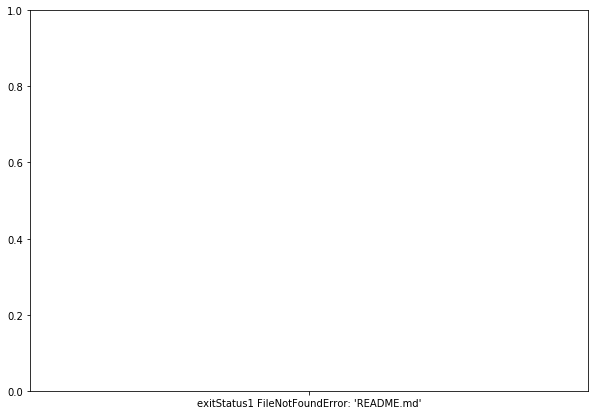

In [737]:
plt.figure(figsize=(10, 7))  
plt.scatter(df_processed['message_processed'], df_processed['error_info'], c=cluster.labels_) 

In [738]:
lst_unique_attribute_values = []
for i in lst_columns_to_analyze:
    try:
        printmd('### Attribute:')
        printmd(i)
        print(df_solver_results_unique_values[i].unique())
        lst_unique_attribute_values.append(df_solver_results_unique_values[i].unique())
    except:
        pass

### Attribute:

metadata_arguments_python_index

['https://pypi.org/simple'
 'https://pypi.org/simple,https://pypi.python.org/simple,https://tensorflow.pypi.thoth-station.ninja/index/manylinux2010/AVX2/simple'
 'https://pypi.org/simple,https://tensorflow.pypi.thoth-station.ninja/index/manylinux2010/AVX2/simple']


### Attribute:

metadata_arguments_python_requirements

['json2html==1.1.0' 'guillotina==1.3.0' 'documenttemplate==2.13.4' ...
 'pycryptopp==0.5.11' 'sphinx-bootstrap-theme==0.1.4' 'annoy==1.0.1']


### Attribute:

metadata_datetime

['2019-12-27T17:17:58.575766' '2019-12-24T16:38:05.389304'
 '2019-12-24T16:38:10.581721' ... '2019-12-26T17:50:45.210001'
 '2019-12-26T17:50:44.151820' '2019-12-26T17:50:45.783992']


### Attribute:

metadata_document_id

['solver-fedora-31-py37-00087c38' 'solver-fedora-31-py37-0009d0a4'
 'solver-fedora-31-py37-000d5133' ... 'solver-fedora-31-py37-147c7e92'
 'solver-fedora-31-py37-147e2623' 'solver-fedora-31-py37-1483b689']


### Attribute:

metadata_duration

[  2   4   1   3   6  19   5   9  44  22  17 104  10  53  11   8   7  43
  21  25  15  47 485  27  97  32  34  12  13  35 110 210  26  33  24  20
  16  62  85  68 143  23  55  39  14 808  52 162 134]


### Attribute:

metadata_hostname

['solver-fedora-31-py37-00087c38-hsv2c'
 'solver-fedora-31-py37-0009d0a4-qdpqp'
 'solver-fedora-31-py37-000d5133-kxp5g' ...
 'solver-fedora-31-py37-147c7e92-wxsg4'
 'solver-fedora-31-py37-147e2623-5dw6n'
 'solver-fedora-31-py37-1483b689-j6tlk']


### Attribute:

metadata_timestamp

[1577467078 1577205485 1577205490 ... 1577382638 1577382645 1577382644]


### Attribute:

result_errors

### Attribute:

result_tree

### Attribute:

result_unresolved

In [104]:
lst_unique_attribute_values

[array(['https://pypi.org/simple',
        'https://pypi.org/simple,https://pypi.python.org/simple,https://tensorflow.pypi.thoth-station.ninja/index/manylinux2010/AVX2/simple',
        'https://pypi.org/simple,https://tensorflow.pypi.thoth-station.ninja/index/manylinux2010/AVX2/simple'],
       dtype=object), array(['json2html==1.1.0', 'guillotina==1.3.0',
        'documenttemplate==2.13.4', ..., 'pycryptopp==0.5.11',
        'sphinx-bootstrap-theme==0.1.4', 'annoy==1.0.1'], dtype=object), array(['2019-12-27T17:17:58.575766', '2019-12-24T16:38:05.389304',
        '2019-12-24T16:38:10.581721', ..., '2019-12-26T17:50:45.210001',
        '2019-12-26T17:50:44.151820', '2019-12-26T17:50:45.783992'],
       dtype=object), array(['solver-fedora-31-py37-00087c38', 'solver-fedora-31-py37-0009d0a4',
        'solver-fedora-31-py37-000d5133', ...,
        'solver-fedora-31-py37-147c7e92', 'solver-fedora-31-py37-147e2623',
        'solver-fedora-31-py37-1483b689'], dtype=object), array([  2,   4,  

# Clustering

### Structure of an error message

In [262]:
solver_results[0]['result']['errors'][0]['details']['message']

'Command exited with non-zero status code (1):     ERROR: Command errored out with exit status 1:\n     command: /home/solver/venv/bin/python3 -c \'import sys, setuptools, tokenize; sys.argv[0] = \'"\'"\'/tmp/pip-install-1eq417ji/json2html/setup.py\'"\'"\'; __file__=\'"\'"\'/tmp/pip-install-1eq417ji/json2html/setup.py\'"\'"\';f=getattr(tokenize, \'"\'"\'open\'"\'"\', open)(__file__);code=f.read().replace(\'"\'"\'\\r\\n\'"\'"\', \'"\'"\'\\n\'"\'"\');f.close();exec(compile(code, __file__, \'"\'"\'exec\'"\'"\'))\' egg_info --egg-base /tmp/pip-install-1eq417ji/json2html/pip-egg-info\n         cwd: /tmp/pip-install-1eq417ji/json2html/\n    Complete output (5 lines):\n    Traceback (most recent call last):\n      File "<string>", line 1, in <module>\n      File "/tmp/pip-install-1eq417ji/json2html/setup.py", line 17, in <module>\n        long_description=open(\'README.md\').read(),\n    FileNotFoundError: [Errno 2] No such file or directory: \'README.md\'\n    -------------------------------

In [158]:
#remove punctuation
def remove_punctuation(text):
    no_punct = "".join([c for c in text if c not in string.punctuation])
    return no_punct

#tokenization
tokenizer = RegexpTokenizer(r'\w+')

#Stopwords
def stopwords_remove(text):
    words = [w for w in text if w not in stopwords.words('english')]
    return words

#remove list
def remove_list(text):
    no_list = ','.join(text)
    return no_list

In [113]:
remove_punctuation(solver_results[0]['result']['errors'][0]['details']['message'])

'Command exited with nonzero status code 1     ERROR Command errored out with exit status 1\n     command homesolvervenvbinpython3 c import sys setuptools tokenize sysargv0  tmppipinstall1eq417jijson2htmlsetuppy filetmppipinstall1eq417jijson2htmlsetuppyfgetattrtokenize open openfilecodefreadreplacern nfcloseexeccompilecode file exec egginfo eggbase tmppipinstall1eq417jijson2htmlpipegginfo\n         cwd tmppipinstall1eq417jijson2html\n    Complete output 5 lines\n    Traceback most recent call last\n      File string line 1 in module\n      File tmppipinstall1eq417jijson2htmlsetuppy line 17 in module\n        longdescriptionopenREADMEmdread\n    FileNotFoundError Errno 2 No such file or directory READMEmd\n    \nERROR Command errored out with exit status 1 python setuppy egginfo Check the logs for full command output\n'

In [270]:
df_error_result

command  \
0     /home/solver/venv/bin/python3 -m pip install --force-reinstall --no-cache-dir --no-deps json2html==1.1.0 --index-url "https://pypi.org/simple"  --trusted-host pypi.org                        
1     /home/solver/venv/bin/python3 -m pip install --force-reinstall --no-cache-dir --no-deps guillotina==1.3.0 --index-url "https://pypi.org/simple"  --trusted-host pypi.org                       
2     /home/solver/venv/bin/python3 -m pip install --force-reinstall --no-cache-dir --no-deps documenttemplate==2.13.4 --index-url "https://pypi.org/simple"  --trusted-host pypi.org                
3     /home/solver/venv/bin/python3 -m pip install --force-reinstall --no-cache-dir --no-deps trytond==3.4.6 --index-url "https://pypi.org/simple"  --trusted-host pypi.org                          
4     /home/solver/venv/bin/python3 -m pip install --force-reinstall --no-cache-dir --no-deps django-markdown-deux==1.0.1 --index-url "https://pypi.org/simple"  --trusted-host pypi.org             
5     /home/solver/venv/bin/python3 -m pip install --force-reinstall --no-cache-dir --no-deps regex==0.1.20130125 --index-url "https://pypi.org/simple"  --trusted-host pypi.org                     
6     /home/solver/venv/bin/python3 -m pip install --force-reinstall --no-cache-dir --no-deps pyamg==1.0.0 --index-url "https://pypi.org/simple"  --trusted-host pypi.org                            
7     /home/solver/venv/bin/python3 -m pip install --force-reinstall --no-cache-dir --no-deps pyobjc-framework-storekit==5.1.1 --index-url "https://pypi.org/simple"  --trusted-host pypi.org        
8     /home/solver/venv/bin/python3 -m pip install --force-reinstall --no-cache-dir --no-deps symsynd==0.4.0 --index-url "https://pypi.org/simple"  --trusted-host pypi.org                          
9     /home/solver/venv/bin/python3 -m pip install --force-reinstall --no-cache-dir --no-deps scrapy==0.8 --index-url "https://pypi.org/simple"  --trusted-host pypi.org                             
10    /home/solver/venv/bin/python3 -m pip install --force-reinstall --no-cache-dir --no-deps pyobjc-framework-network==5.1.2 --index-url "https://pypi.org/simple"  --trusted-host pypi.org         
11    /home/solver/venv/bin/python3 -m pip install --force-reinstall --no-cache-dir --no-deps cbapi==0.9.0 --index-url "https://pypi.org/simple"  --trusted-host pypi.org                            
12    /home/solver/venv/bin/python3 -m pip install --force-reinstall --no-cache-dir --no-deps aspen==0.11.11 --index-url "https://pypi.org/simple"  --trusted-host pypi.org                          
13    /home/solver/venv/bin/python3 -m pip install --force-reinstall --no-cache-dir --no-deps premailer==2.0.1 --index-url "https://pypi.org/simple"  --trusted-host pypi.org                        
14    /home/solver/venv/bin/python3 -m pip install --force-reinstall --no-cache-dir --no-deps aspen==0.11.3 --index-url "https://pypi.org/simple"  --trusted-host pypi.org                           
15    /home/solver/venv/bin/python3 -m pip install --force-reinstall --no-cache-dir --no-deps tiddlyweb==1.2.26 --index-url "https://pypi.org/simple"  --trusted-host pypi.org                       
16    /home/solver/venv/bin/python3 -m pip install --force-reinstall --no-cache-dir --no-deps conda==4.0.1 --index-url "https://pypi.org/simple"  --trusted-host pypi.org                            
17    /home/solver/venv/bin/python3 -m pip install --force-reinstall --no-cache-dir --no-deps astropy==1.1.post2 --index-url "https://pypi.org/simple"  --trusted-host pypi.org                      
18    /home/solver/venv/bin/python3 -m pip install --force-reinstall --no-cache-dir --no-deps lupa==0.2 --index-url "https://pypi.org/simple"  --trusted-host pypi.org                               
19    /home/solver/venv/bin/python3 -m pip install --force-reinstall --no-cache-dir --no-deps formencode==0.7.1 --index-url "https://pypi.org/simple"  --trusted-host pypi.org                       
20    /home/solver/venv/bin/p

In [271]:
df = df_error_result[df_error_result['stderr'].str.contains("ommand errored out with exit")]

In [272]:
df

command  \
0     /home/solver/venv/bin/python3 -m pip install --force-reinstall --no-cache-dir --no-deps json2html==1.1.0 --index-url "https://pypi.org/simple"  --trusted-host pypi.org                        
1     /home/solver/venv/bin/python3 -m pip install --force-reinstall --no-cache-dir --no-deps guillotina==1.3.0 --index-url "https://pypi.org/simple"  --trusted-host pypi.org                       
2     /home/solver/venv/bin/python3 -m pip install --force-reinstall --no-cache-dir --no-deps documenttemplate==2.13.4 --index-url "https://pypi.org/simple"  --trusted-host pypi.org                
3     /home/solver/venv/bin/python3 -m pip install --force-reinstall --no-cache-dir --no-deps trytond==3.4.6 --index-url "https://pypi.org/simple"  --trusted-host pypi.org                          
4     /home/solver/venv/bin/python3 -m pip install --force-reinstall --no-cache-dir --no-deps django-markdown-deux==1.0.1 --index-url "https://pypi.org/simple"  --trusted-host pypi.org             
5     /home/solver/venv/bin/python3 -m pip install --force-reinstall --no-cache-dir --no-deps regex==0.1.20130125 --index-url "https://pypi.org/simple"  --trusted-host pypi.org                     
6     /home/solver/venv/bin/python3 -m pip install --force-reinstall --no-cache-dir --no-deps pyamg==1.0.0 --index-url "https://pypi.org/simple"  --trusted-host pypi.org                            
7     /home/solver/venv/bin/python3 -m pip install --force-reinstall --no-cache-dir --no-deps pyobjc-framework-storekit==5.1.1 --index-url "https://pypi.org/simple"  --trusted-host pypi.org        
8     /home/solver/venv/bin/python3 -m pip install --force-reinstall --no-cache-dir --no-deps symsynd==0.4.0 --index-url "https://pypi.org/simple"  --trusted-host pypi.org                          
9     /home/solver/venv/bin/python3 -m pip install --force-reinstall --no-cache-dir --no-deps scrapy==0.8 --index-url "https://pypi.org/simple"  --trusted-host pypi.org                             
10    /home/solver/venv/bin/python3 -m pip install --force-reinstall --no-cache-dir --no-deps pyobjc-framework-network==5.1.2 --index-url "https://pypi.org/simple"  --trusted-host pypi.org         
12    /home/solver/venv/bin/python3 -m pip install --force-reinstall --no-cache-dir --no-deps aspen==0.11.11 --index-url "https://pypi.org/simple"  --trusted-host pypi.org                          
13    /home/solver/venv/bin/python3 -m pip install --force-reinstall --no-cache-dir --no-deps premailer==2.0.1 --index-url "https://pypi.org/simple"  --trusted-host pypi.org                        
14    /home/solver/venv/bin/python3 -m pip install --force-reinstall --no-cache-dir --no-deps aspen==0.11.3 --index-url "https://pypi.org/simple"  --trusted-host pypi.org                           
15    /home/solver/venv/bin/python3 -m pip install --force-reinstall --no-cache-dir --no-deps tiddlyweb==1.2.26 --index-url "https://pypi.org/simple"  --trusted-host pypi.org                       
16    /home/solver/venv/bin/python3 -m pip install --force-reinstall --no-cache-dir --no-deps conda==4.0.1 --index-url "https://pypi.org/simple"  --trusted-host pypi.org                            
17    /home/solver/venv/bin/python3 -m pip install --force-reinstall --no-cache-dir --no-deps astropy==1.1.post2 --index-url "https://pypi.org/simple"  --trusted-host pypi.org                      
19    /home/solver/venv/bin/python3 -m pip install --force-reinstall --no-cache-dir --no-deps formencode==0.7.1 --index-url "https://pypi.org/simple"  --trusted-host pypi.org                       
20    /home/solver/venv/bin/python3 -m pip install --force-reinstall --no-cache-dir --no-deps biopython==1.53 --index-url "https://pypi.org/simple"  --trusted-host pypi.org                         
21    /home/solver/venv/bin/python3 -m pip install --force-reinstall --no-cache-dir --no-deps pylint==0.21.2 --index-url "https://pypi.org/simple"  --trusted-host pypi.org                          
22    /home/solver/venv/bin/p

In [114]:
#Apply to all of the dataframe
df_error_result = pd.DataFrame(
    columns=list(solver_results[0]['result']['errors'][0]['details'].keys()))

In [115]:
count = 0
lst_exceptions = []
for i in solver_results:
    #print(i['result']['errors'][0]['details']['command'])
    #print(type(i['result']['errors'][0]['details']['command']))
    try:
        df_error_result = df_error_result.append({
        "command": i['result']['errors'][0]['details']['command'],
        "message": i['result']['errors'][0]['details']['message'],
        "return_code": i['result']['errors'][0]['details']['return_code'],
        "stderr": i['result']['errors'][0]['details']['stderr'],
        "stdout": i['result']['errors'][0]['details']['stdout'],
        "timeout": i['result']['errors'][0]['details']['timeout']}, 
        ignore_index=True)
    except:
        lst_exceptions.append(i)
    count+=1
    clear_output()
    print(count)

2000


In [229]:
df_error_result['message'].head(1)

0    Command exited with non-zero status code (1):     ERROR: Command errored out with exit status 1:\n     command: /home/solver/venv/bin/python3 -c 'import sys, setuptools, tokenize; sys.argv[0] = '"'"'/tmp/pip-install-1eq417ji/json2html/setup.py'"'"'; __file__='"'"'/tmp/pip-install-1eq417ji/json2html/setup.py'"'"';f=getattr(tokenize, '"'"'open'"'"', open)(__file__);code=f.read().replace('"'"'\r\n'"'"', '"'"'\n'"'"');f.close();exec(compile(code, __file__, '"'"'exec'"'"'))' egg_info --egg-base /tmp/pip-install-1eq417ji/json2html/pip-egg-info\n         cwd: /tmp/pip-install-1eq417ji/json2html/\n    Complete output (5 lines):\n    Traceback (most recent call last):\n      File "<string>", line 1, in <module>\n      File "/tmp/pip-install-1eq417ji/json2html/setup.py", line 17, in <module>\n        long_description=open('README.md').read(),\n    FileNotFoundError: [Errno 2] No such file or directory: 'README.md'\n    ----------------------------------------\nERROR: Command errored out wit

In [142]:
import nltk

In [143]:
nltk.download('stopwords')

[nltk_data] Downloading package stopwords to /opt/app-
[nltk_data]     root/src/nltk_data...
[nltk_data]   Unzipping corpora/stopwords.zip.


True

In [148]:
df_error_result['message_processed'] = df_error_result['message'].apply(lambda x: remove_punctuation(x))
df_error_result['message_processed'] = df_error_result['message_processed'].apply(lambda x: tokenizer.tokenize(x.lower()))
df_error_result['message_processed'] = df_error_result['message_processed'].apply(lambda x: stopwords_remove(x))

In [160]:
df_error_result['string_message_processed'] = df_error_result['message_processed'].apply(lambda x: remove_list(x))

In [151]:
pd.set_option('display.max_colwidth', -1)
df_error_result['message_processed'].head(1)

0    [command, exited, nonzero, status, code, 1, error, command, errored, exit, status, 1, command, homesolvervenvbinpython3, c, import, sys, setuptools, tokenize, sysargv0, tmppipinstall1eq417jijson2htmlsetuppy, filetmppipinstall1eq417jijson2htmlsetuppyfgetattrtokenize, open, openfilecodefreadreplacern, nfcloseexeccompilecode, file, exec, egginfo, eggbase, tmppipinstall1eq417jijson2htmlpipegginfo, cwd, tmppipinstall1eq417jijson2html, complete, output, 5, lines, traceback, recent, call, last, file, string, line, 1, module, file, tmppipinstall1eq417jijson2htmlsetuppy, line, 17, module, longdescriptionopenreadmemdread, filenotfounderror, errno, 2, file, directory, readmemd, error, command, errored, exit, status, 1, python, setuppy, egginfo, check, logs, full, command, output]
Name: message_processed, dtype: object

In [152]:
df_error_result['message'].head(1)

0    Command exited with non-zero status code (1):     ERROR: Command errored out with exit status 1:\n     command: /home/solver/venv/bin/python3 -c 'import sys, setuptools, tokenize; sys.argv[0] = '"'"'/tmp/pip-install-1eq417ji/json2html/setup.py'"'"'; __file__='"'"'/tmp/pip-install-1eq417ji/json2html/setup.py'"'"';f=getattr(tokenize, '"'"'open'"'"', open)(__file__);code=f.read().replace('"'"'\r\n'"'"', '"'"'\n'"'"');f.close();exec(compile(code, __file__, '"'"'exec'"'"'))' egg_info --egg-base /tmp/pip-install-1eq417ji/json2html/pip-egg-info\n         cwd: /tmp/pip-install-1eq417ji/json2html/\n    Complete output (5 lines):\n    Traceback (most recent call last):\n      File "<string>", line 1, in <module>\n      File "/tmp/pip-install-1eq417ji/json2html/setup.py", line 17, in <module>\n        long_description=open('README.md').read(),\n    FileNotFoundError: [Errno 2] No such file or directory: 'README.md'\n    ----------------------------------------\nERROR: Command errored out wit

In [161]:
df_error_result['string_message_processed'].head(1)

0    command,exited,nonzero,status,code,1,error,command,errored,exit,status,1,command,homesolvervenvbinpython3,c,import,sys,setuptools,tokenize,sysargv0,tmppipinstall1eq417jijson2htmlsetuppy,filetmppipinstall1eq417jijson2htmlsetuppyfgetattrtokenize,open,openfilecodefreadreplacern,nfcloseexeccompilecode,file,exec,egginfo,eggbase,tmppipinstall1eq417jijson2htmlpipegginfo,cwd,tmppipinstall1eq417jijson2html,complete,output,5,lines,traceback,recent,call,last,file,string,line,1,module,file,tmppipinstall1eq417jijson2htmlsetuppy,line,17,module,longdescriptionopenreadmemdread,filenotfounderror,errno,2,file,directory,readmemd,error,command,errored,exit,status,1,python,setuppy,egginfo,check,logs,full,command,output
Name: string_message_processed, dtype: object

In [ ]:
#These have not appended for some reason
#lst_exceptions

In [31]:
df_error_result_two = pd.DataFrame(
    columns=list(solver_results[0]['result']['errors'][0]['details'].keys()))

In [32]:
count = 0
for i in solver_results:
    #print(i['result']['errors'][0]['details']['command'])
    #print(type(i['result']['errors'][0]['details']['command']))
    try:
        df_error_result_two = df_error_result_two.append({
        #"command": i['result']['errors'][0]['details']['command'],
        "message": i['result']['errors'][0]['details']['message']},
        #"return_code": i['result']['errors'][0]['details']['return_code'],
        #"stderr": i['result']['errors'][0]['details']['stderr'],
        #"stdout": i['result']['errors'][0]['details']['stdout'],
        #"timeout": i['result']['errors'][0]['details']['timeout']}, 
        ignore_index=True)
    except:
        pass
    count+=1
    clear_output()
    print(count)

2000


In [154]:
#df_error_result_two.head()

In [162]:
from sklearn.feature_extraction.text import TfidfVectorizer
v = TfidfVectorizer()
x = v.fit_transform(df_error_result['string_message_processed'])
x.toarray()
pd.DataFrame(x.toarray(), columns=v.get_feature_names()).head()
from sklearn.cluster import KMeans

def draw(ax, df):
    colormap = { 0: 'red', 1: 'green', 2: 'blue', 3: 'orange' }
    colors = df.apply(lambda row: colormap[row.category], axis=1)

    ax.scatter(df['copying'], df['creating'], df['buildliblinuxx866437guillotinastaticexecutionerassetsicons'], c=colors, s=100, alpha=0.5)
    ax.set_xlabel('Copying')
    ax.set_ylabel('Creating')
    ax.set_zlabel('BuildLib')

chart_count_vert = 5
chart_count_horiz = 5
number_of_graphs = chart_count_vert * chart_count_horiz

number_of_clusters = 20
km = KMeans(n_clusters=number_of_clusters)
km.fit(x)
km.fit

printmd("### Top terms per cluster:")
order_centroids = km.cluster_centers_.argsort()[:, ::-1]
terms = v.get_feature_names()
for i in range(number_of_clusters):
    top_ten_words = [terms[ind] for ind in order_centroids[i, :5]]
    printmd("###### Cluster {}: {}".format(i, ' '.join(top_ten_words)))

In [163]:
x.toarray()

array([[0., 0., 0., ..., 0., 0., 0.],
       [0., 0., 0., ..., 0., 0., 0.],
       [0., 0., 0., ..., 0., 0., 0.],
       ...,
       [0., 0., 0., ..., 0., 0., 0.],
       [0., 0., 0., ..., 0., 0., 0.],
       [0., 0., 0., ..., 0., 0., 0.]])

In [165]:
pd.DataFrame(x.toarray(), columns=v.get_feature_names()).head()

,000,000linuxx8664,001,0010,0011,0017,0018,001a1,002,0020,...,zstdlibcompresszstdcompressc,zvm,zvmsdk,¼v,å2,åå,æsæ,æå,üm,ƒⁿ
0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
1,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
2,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
3,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
4,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0


In [166]:
from sklearn.cluster import KMeans

In [220]:
def draw(ax, df):
    colormap = { 0: 'red', 1: 'green', 2: 'blue', 3: 'orange' }
    colors = df.apply(lambda row: colormap[row.category], axis=1)

    ax.scatter(df['copying'], df['creating'], df['buildliblinuxx866437guillotinastaticexecutionerassetsicons'], c=colors, s=100, alpha=0.5)
    ax.set_xlabel('Copying')
    ax.set_ylabel('Creating')
    ax.set_zlabel('BuildLib')

chart_count_vert = 5
chart_count_horiz = 5
number_of_graphs = chart_count_vert * chart_count_horiz

In [167]:
number_of_clusters = 20
km = KMeans(n_clusters=number_of_clusters)
km.fit(x)
km.fit

<bound method KMeans.fit of KMeans(algorithm='auto', copy_x=True, init='k-means++', max_iter=300,
    n_clusters=20, n_init=10, n_jobs=None, precompute_distances='auto',
    random_state=None, tol=0.0001, verbose=0)>

printmd("### Top terms per cluster:")
order_centroids = km.cluster_centers_.argsort()[:, ::-1]
terms = v.get_feature_names()
for i in range(number_of_clusters):
    top_ten_words = [terms[ind] for ind in order_centroids[i, :5]]
    printmd("###### Cluster {}: {}".format(i, ' '.join(top_ten_words)))

In [178]:
km.labels_

array([17, 12, 12, ..., 17,  2,  5], dtype=int32)

df_clustered = pd.DataFrame()
df_clustered['messages_processed'] = df_error_result['string_message_processed']
df_clustered['category'] = km.labels_
df_clustered

In [224]:
vec = TfidfVectorizer(stop_words='english',
                      use_idf=True,
                     max_features=10)
matrix = vec.fit_transform(df_error_result['string_message_processed'])
df = pd.DataFrame(matrix.toarray(), columns=vec.get_feature_names())
df.head()

,buildliblinuxx866437guillotinastaticexecutionerassetsicons,command,copying,creating,error,exit,file,line,output,status
0,0.0,0.543395,0.000000,0.000000,0.217468,0.269268,0.538814,0.340291,0.269268,0.326037
1,0.0,0.006494,0.991849,0.126740,0.004331,0.004469,0.008049,0.000000,0.002681,0.004329
2,0.0,0.035274,0.973713,0.216377,0.023528,0.024277,0.043721,0.000000,0.014566,0.023516
3,0.0,0.581584,0.000000,0.000000,0.232751,0.288191,0.432511,0.364206,0.288191,0.348951
4,0.0,0.507880,0.000000,0.000000,0.203255,0.251669,0.503598,0.477075,0.251669,0.304728


In [217]:
vec = TfidfVectorizer(stop_words='english',
                      use_idf=True)
matrix = vec.fit_transform(df_error_result['string_message_processed'])
df = pd.DataFrame(matrix.toarray(), columns=vec.get_feature_names())
df.head()

,000,000linuxx8664,001,0010,0011,0017,0018,001a1,002,0020,...,zstdlibcompresszstdcompressc,zvm,zvmsdk,¼v,å2,åå,æsæ,æå,üm,ƒⁿ
0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
1,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
2,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
3,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
4,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0


Text(0, 0.5, 'Creating')

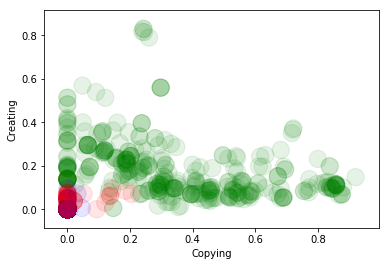

In [218]:
km = KMeans(n_clusters=3)
km.fit(matrix)
df['category'] = km.labels_

colormap = { 0: 'red', 1: 'green', 2: 'blue'}
colors = df.apply(lambda row: colormap[row.category], axis=1)
ax = df.plot(kind='scatter', x='copying', y='creating', alpha=0.1, s=300, c=colors)
ax.set_xlabel("Copying")
ax.set_ylabel("Creating")

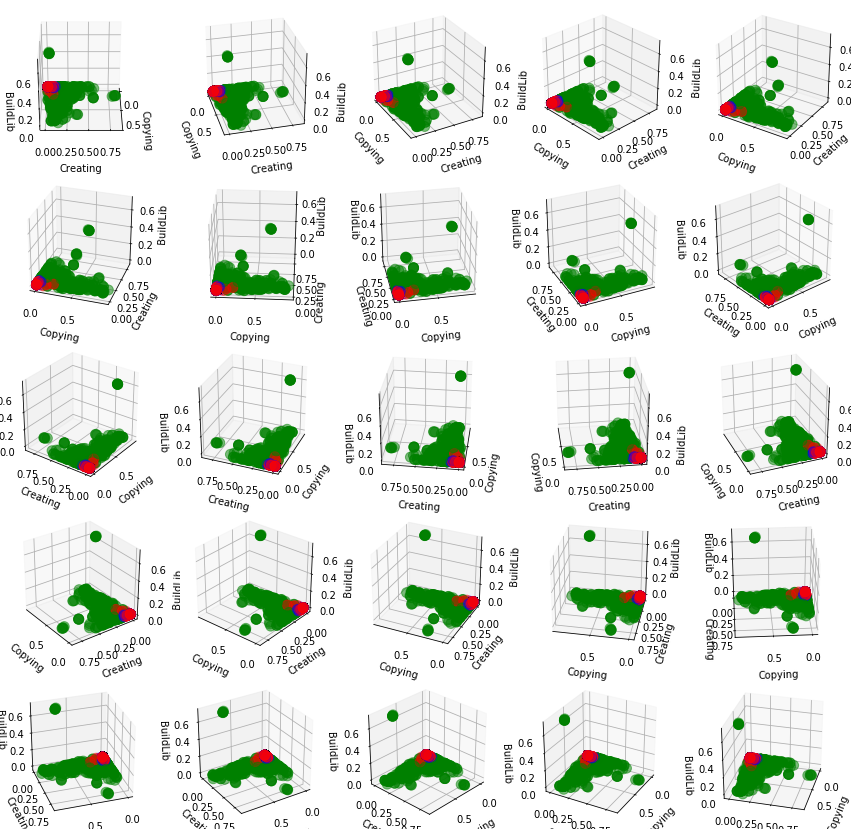

In [219]:
fig = plt.figure(figsize=(3 * chart_count_horiz, 3 * chart_count_vert))

for i in range(number_of_graphs):
    ax = fig.add_subplot(chart_count_horiz, chart_count_vert, i + 1, projection='3d', azim=(-360 / number_of_graphs) * i)
    draw(ax, df)

Inspect the data
Data preprocessing:
- Clean the data
- Drop blank rows
- Drop duplicate rows
- Stop work removal 
- English word processing

Clustering 
- Nearest neigbors clustering used to identified preprocessed text (identify similarity between unlabeled strings)

- TFIDF vectorizing
- singular value decomposition

- kmeans and use elblow curve 
- score and evaluate clustering results

Import the text
Remove introductory sentences, fixed patterns, speaker names, tokenize, stop words, make sure that it is in english
Bigrams- identify word pairs
Document term matrix- bag of words, vectorization

In [190]:
df_test.columns

Index(['firstname', 'lastname'], dtype='object')

In [ ]:
# Reproducible runs until there are no new documents.
ANSWER_TO_THE_ULTIMATE_QUESTION_OF_LIFE_THE_UNIVERSE_AND_EVERYTHING = 42
random.seed(ANSWER_TO_THE_ULTIMATE_QUESTION_OF_LIFE_THE_UNIVERSE_AND_EVERYTHING)
np.random.seed(ANSWER_TO_THE_ULTIMATE_QUESTION_OF_LIFE_THE_UNIVERSE_AND_EVERYTHING)


SOLVER_DOCUMENTS_CONSIDERED_COUNT = 2000
NUMBER_OF_CLUSTERS = 20
KMEANS_ITERATIONS = 200

In [ ]:
random.shuffle(solver_ids)

In [ ]:
solver_documents_considered = []
for solver_document_id in solver_ids:
    document = solver_store.retrieve_document(solver_document_id)
    if len(document["result"]["errors"]) == 1 and document["result"]["errors"][0].get("is_provided_package_version") is True:
        solver_documents_considered.append(document)
        print(
            f"\rSolver documents considered for training {len(solver_documents_considered)}/{SOLVER_DOCUMENTS_CONSIDERED_COUNT}",
            end=""
        )

        if len(solver_documents_considered) == SOLVER_DOCUMENTS_CONSIDERED_COUNT:
            break

len(f"Solver documents considered for training {solver_documents_considered}")

In [ ]:
print("A sample of an error in training dataset:")
print(random.choice(solver_documents_considered)["result"]["errors"][0]["details"]["message"])

In [ ]:
texts = [err["result"]["errors"][0]["details"]["message"] for err in solver_documents_considered]

In [ ]:
vectorizer = TfidfVectorizer(stop_words='english')
X = vectorizer.fit_transform(texts)

In [ ]:
model = KMeans(
    n_clusters=NUMBER_OF_CLUSTERS, 
    max_iter=KMEANS_ITERATIONS,
)

model.fit(X)

In [ ]:
centroids = model.cluster_centers_.argsort()[:, ::-1]
terms = vectorizer.get_feature_names()

for i in range(NUMBER_OF_CLUSTERS):
    print(f"Centroids for cluster {i}.:"),
    for idx in centroids[i, :NUMBER_OF_CLUSTERS]:
        print(f"\t{terms[idx]}")

In [ ]:
# Find a sample and predict a cluster.

sample_document = random.choice(solver_results)
sample = sample_document["result"]["errors"][0]["details"]["message"]
print(sample)
print(f"Using sample {sample_solver_document_id!r} to predict cluster")

In [ ]:
X = vectorizer.transform([sample])

cluster = model.predict(X)[0]

print(f"Sample {sample_solver_document_id!r} belongs to cluster number {cluster}")

In [170]:
import os
import json
from pprint import pprint
import random

import numpy as np
import pandas as pd
from sklearn.feature_extraction.text import TfidfVectorizer
from sklearn.cluster import KMeans

from thoth.storages import SolverResultsStore

# Reproducible runs until there are no new documents.
ANSWER_TO_THE_ULTIMATE_QUESTION_OF_LIFE_THE_UNIVERSE_AND_EVERYTHING = 42
random.seed(ANSWER_TO_THE_ULTIMATE_QUESTION_OF_LIFE_THE_UNIVERSE_AND_EVERYTHING)
np.random.seed(ANSWER_TO_THE_ULTIMATE_QUESTION_OF_LIFE_THE_UNIVERSE_AND_EVERYTHING)


SOLVER_DOCUMENTS_CONSIDERED_COUNT = 2000
NUMBER_OF_CLUSTERS = 20
KMEANS_ITERATIONS = 200

In [ ]:
solvers = SolverResultsStore(
    deployment_name="thoth-psi-stage",
    host="https://s3.upshift.redhat.com",
    bucket="thoth",
    prefix="data/thoth",
    key_id=os.environ["AWS_ACCESS_KEY_ID"],
    secret_key=os.environ["AWS_SECRET_ACCESS_KEY"]
)
solvers.connect()

In [ ]:
all_solver_documents = list(solvers.get_document_listing())
random.shuffle(all_solver_documents)

In [172]:
solver_documents_considered = []
for solver_document_id in all_solver_documents:
    document = solvers.retrieve_document(solver_document_id)
    if len(document["result"]["errors"]) == 1 and document["result"]["errors"][0].get("is_provided_package_version") is True:
        solver_documents_considered.append(document)
        print(
            f"\rSolver documents considered for training {len(solver_documents_considered)}/{SOLVER_DOCUMENTS_CONSIDERED_COUNT}",
            end=""
        )

        if len(solver_documents_considered) == SOLVER_DOCUMENTS_CONSIDERED_COUNT:
            break

len(f"Solver documents considered for training {solver_documents_considered}")

NameError: name 'all_solver_documents' is not defined

In [171]:
print("A sample of an error in training dataset:")
print(random.choice(solver_documents_considered)["result"]["errors"][0]["details"]["message"])

A sample of an error in training dataset:


NameError: name 'solver_documents_considered' is not defined

In [ ]:
texts = [err["result"]["errors"][0]["details"]["message"] for err in solver_documents_considered]

In [ ]:
vectorizer = TfidfVectorizer(stop_words='english')
X = vectorizer.fit_transform(texts)

In [ ]:
model = KMeans(
    n_clusters=NUMBER_OF_CLUSTERS, 
    max_iter=KMEANS_ITERATIONS,
)

model.fit(X)

In [ ]:
centroids = model.cluster_centers_.argsort()[:, ::-1]
terms = vectorizer.get_feature_names()

for i in range(NUMBER_OF_CLUSTERS):
    print(f"Centroids for cluster {i}.:"),
    for idx in centroids[i, :NUMBER_OF_CLUSTERS]:
        print(f"\t{terms[idx]}")

In [ ]:
# Find a sample and predict a cluster.

while True:
    sample_solver_document_id = random.choice(all_solver_documents)
    if (
        len(document["result"]["errors"]) != 1 \
        or document["result"]["errors"][0].get("is_provided_package_version") is not True
    ):
        continue

    sample_document = solvers.retrieve_document(sample_solver_document_id)
    sample = sample_document["result"]["errors"][0]["details"]["message"]
    print(f"Using sample {sample_solver_document_id!r} to predict cluster")
    break

In [ ]:
print(sample)

In [ ]:
X = vectorizer.transform([sample])

cluster = model.predict(X)[0]

print(f"Sample {sample_solver_document_id!r} belongs to cluster number {cluster}")

## Links

https://towardsdatascience.com/nlp-for-beginners-cleaning-preprocessing-text-data-ae8e306bef0f

http://jonathansoma.com/lede/algorithms-2017/classes/clustering/k-means-clustering-with-scikit-learn/